**Requires**
* `'trapnell_cpa_lincs_genes.h5ad'`
* `'trapnell_cpa.h5ad'`

**Output**
* `'sciplex_complete.h5ad'`
* `'sciplex_complete_lincs_genes.h5ad'`

## Imports

In [2]:
import os 
import scanpy as sc
import matplotlib
import matplotlib.pyplot as plt
import numpy as np 
import pandas as pd
import seaborn as sns
import sfaira

from compert.paths import DATA_DIR, PROJECT_DIR
from rdkit import Chem, DataStructs
from rdkit.Chem import Draw
from rdkit.Chem.Draw import IPythonConsole

IPythonConsole.ipython_useSVG = False
matplotlib.style.use("fivethirtyeight")
matplotlib.style.use("seaborn-talk")
matplotlib.rcParams['font.family'] = "monospace"
matplotlib.rcParams['figure.dpi'] = 200
matplotlib.pyplot.rcParams['savefig.facecolor'] = 'white'
os.getcwd()
pd.set_option('display.max_columns', 100)
sc.set_figure_params(dpi=80, frameon=False)
sc.logging.print_header()
sns.set_context("poster")

scanpy==1.8.2 anndata==0.7.8 umap==0.5.2 numpy==1.21.5 scipy==1.7.3 pandas==1.3.5 scikit-learn==1.0.2 statsmodels==0.13.1 pynndescent==0.5.5


In [3]:
%load_ext autoreload
%autoreload 2

## Load data

In [3]:
adata_sciplex_lincs_genes = sc.read(PROJECT_DIR/'datasets'/'trapnell_cpa_lincs_genes.h5ad')
adata_sciplex = sc.read(PROJECT_DIR/'datasets'/'trapnell_cpa.h5ad')

In [4]:
sc.pp.highly_variable_genes(adata_sciplex_lincs_genes, n_top_genes=977)

In [5]:
sc.pp.highly_variable_genes(adata_sciplex, n_top_genes=2000)

## Compute UMAP

In [6]:
! mamba list | grep pynndescent
! mamba list | grep umap

pynndescent               0.5.5              pyh6c4a22f_0    conda-forge
umap-learn                0.5.2            py37h89c1867_0    conda-forge


In [7]:
def preprocess_adata(adata, n_comps=25, n_neighbors=50):
    sc.pp.pca(adata, n_comps=n_comps)
    sc.pp.neighbors(adata, n_neighbors=n_neighbors, metric='cosine')
    sc.tl.umap(adata, min_dist=0.1)
    return None
    
def preprocess_adata_subset_type(adata, cell_type, n_comps=25):
    adata_new = adata[adata.obs.cell_type == cell_type].copy()
    sc.pp.pca(adata_new, n_comps=n_comps)
    sc.pp.neighbors(adata_new, n_neighbors=50, metric='cosine')
    sc.tl.umap(adata_new, min_dist=0.1)
    return adata_new

In [8]:
preprocess_adata(adata_sciplex, n_comps=25, n_neighbors=50)

OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [9]:
preprocess_adata(adata_sciplex_lincs_genes)

## Load or create subsetted adata objects

In [10]:
fname = PROJECT_DIR/'datasets'/'adata_MCF7.h5ad'
if not fname.exists():
    adata_MCF7 = preprocess_adata_subset_type(adata_sciplex, "MCF7")
    sc.write(fname, adata_MCF7)
else: 
    adata_MCF7 = sc.read(fname)
    
fname = PROJECT_DIR/'datasets'/'adata_MCF7_lincs_genes.h5ad'    
if not fname.exists():
    adata_MCF7_lincs_genes = preprocess_adata_subset_type(adata_sciplex_lincs_genes, "MCF7")
    sc.write(fname, adata_MCF7_lincs_genes)
else: 
    adata_MCF7_lincs_genes = sc.read(fname)

fname = PROJECT_DIR/'datasets'/'adata_K562.h5ad'
if not fname.exists():
    adata_K562 = preprocess_adata_subset_type(adata_sciplex, "K562")
    sc.write(fname, adata_K562)
else: 
    adata_K562 = sc.read(fname)

fname = PROJECT_DIR/'datasets'/'adata_K562_lincs_genes.h5ad'
if not fname.exists():
    adata_K562_lincs_genes = preprocess_adata_subset_type(adata_sciplex_lincs_genes, "K562")
    sc.write(fname, adata_K562_lincs_genes)
else: 
    adata_K562_lincs_genes = sc.read(fname)

fname = PROJECT_DIR/'datasets'/'adata_A549.h5ad'
if not fname.exists():    
    adata_A549 = preprocess_adata_subset_type(adata_sciplex, "A549")
    sc.write(fname, adata_A549)
else: 
    adata_A549 = sc.read(fname)

fname = PROJECT_DIR/'datasets'/'adata_A549_lincs_genes.h5ad'
if not fname.exists():    
    adata_A549_lincs_genes = preprocess_adata_subset_type(adata_sciplex_lincs_genes, "A549")
    sc.write(fname, adata_A549_lincs_genes)
else: 
    adata_A549_lincs_genes = sc.read(fname)

## Plot pathways for different cell lines

In [11]:
pathways = [
#     'Antioxidant', 
    'Apoptotic regulation', 
    'Cell cycle regulation',
    'DNA damage & DNA repair', 
    'Epigenetic regulation',
#     'Focal adhesion signaling', 
    'HIF signaling', 
    'JAK/STAT signaling',
#     'Metabolic regulation', 
#     'Neuronal signaling',
    'Nuclear receptor signaling', 
#     'Other', 
    'PKC signaling',
    'Protein folding & Protein degradation', 
#     'TGF/BMP signaling',
    'Tyrosine kinase signaling', 
#     'Vehicle'
]


### LINCS genes

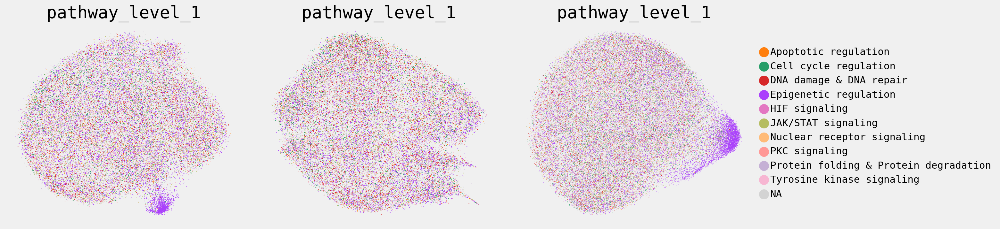

In [12]:
dose = 1e4

fig, ax = plt.subplots(1, 3, figsize=(20, 5))

sc.pl.umap(
    adata_A549_lincs_genes[adata_A549_lincs_genes.obs.dose==dose].copy(), 
    color='pathway_level_1', 
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[0]
)
sc.pl.umap(
    adata_K562_lincs_genes[adata_K562_lincs_genes.obs.dose==dose].copy(), 
    color='pathway_level_1',
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[1]
)
sc.pl.umap(
    adata_MCF7_lincs_genes[adata_MCF7_lincs_genes.obs.dose==dose].copy(), 
    color='pathway_level_1',
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[2]
)
ax[0].get_legend().remove()
ax[1].get_legend().remove()
plt.tight_layout()

### All genes

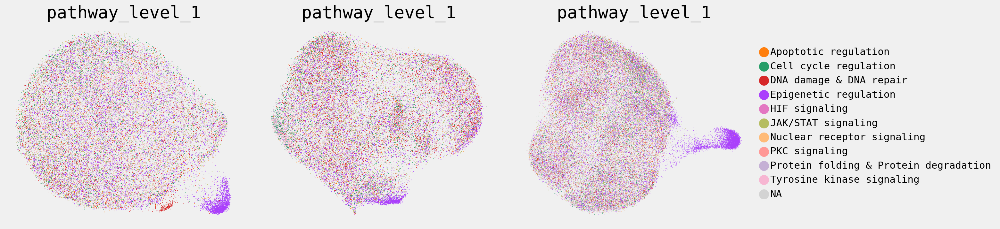

In [13]:
dose = 1e4

fig, ax = plt.subplots(1, 3, figsize=(20, 5))

sc.pl.umap(
    adata_A549[adata_A549.obs.dose==dose].copy(), 
    color='pathway_level_1', 
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[0]
)
sc.pl.umap(
    adata_K562[adata_K562.obs.dose==dose].copy(), 
    color='pathway_level_1',
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[1]
)
sc.pl.umap(
    adata_MCF7[adata_MCF7.obs.dose==dose].copy(), 
    color='pathway_level_1',
    groups=pathways,
    legend_fontsize='xx-small',
    show=False, 
    ax=ax[2]
)
ax[0].get_legend().remove()
ax[1].get_legend().remove()
plt.tight_layout()

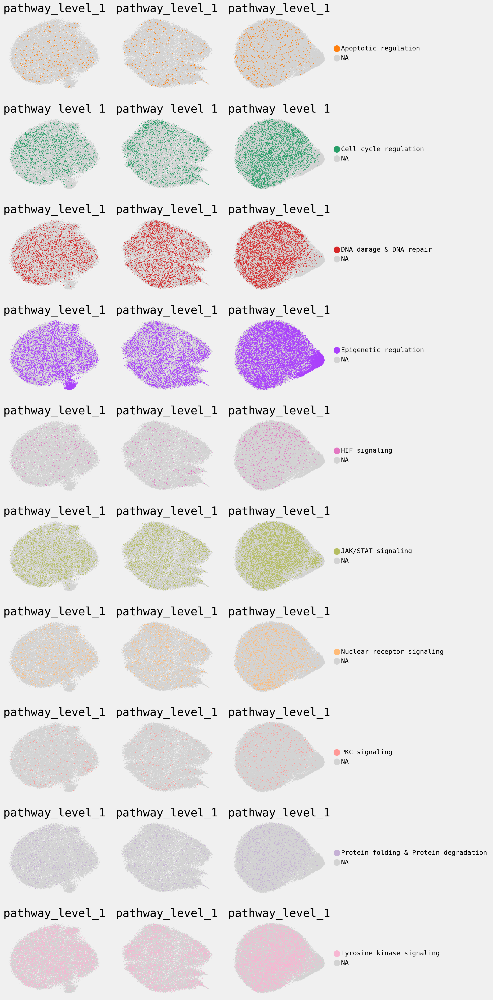

In [14]:
dose = 1e4
cond_A549 = adata_A549_lincs_genes.obs.dose==dose
cond_K562 = adata_K562_lincs_genes.obs.dose==dose
cond_MCF7 = adata_MCF7_lincs_genes.obs.dose==dose

cols = 3
rows = len(pathways)
size = 7
fig, ax = plt.subplots(rows, cols, figsize=(5*cols, 3*rows))

for i, pw in enumerate(pathways):
    sc.pl.umap(adata_A549_lincs_genes[cond_A549].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               size=size,
               label=None,
              )

    sc.pl.umap(adata_K562_lincs_genes[cond_K562].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               size=size,
               label=None,
              )
    sc.pl.umap(adata_MCF7_lincs_genes[cond_MCF7].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               size=size
              ) 
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()

## Distribution of pathways for perturbations with maximal dosage

### Lincs genes

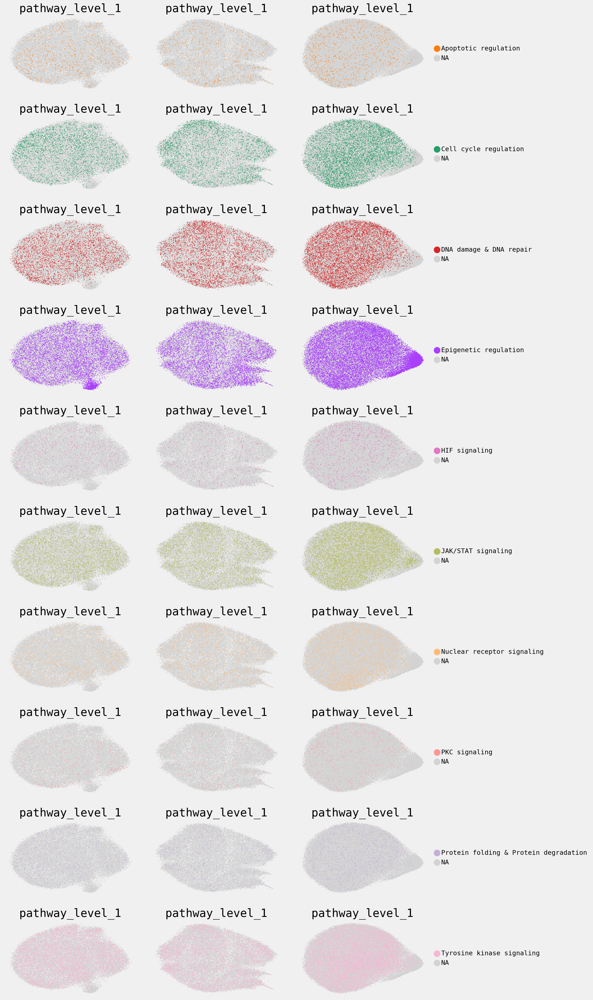

In [15]:
dose = 1e4
cond_A549 = adata_A549_lincs_genes.obs.dose==dose
cond_K562 = adata_K562_lincs_genes.obs.dose==dose
cond_MCF7 = adata_MCF7_lincs_genes.obs.dose==dose

cols = 3
rows = len(pathways)
size = 7
fig, ax = plt.subplots(rows, cols, figsize=(6*cols, 3*rows))

for i, pw in enumerate(pathways):
    sc.pl.umap(adata_A549_lincs_genes[cond_A549].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               size=size
              )
    sc.pl.umap(adata_K562_lincs_genes[cond_K562].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               size=size
              )
    sc.pl.umap(adata_MCF7_lincs_genes[cond_MCF7].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               size=size
              )
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()

### All genes

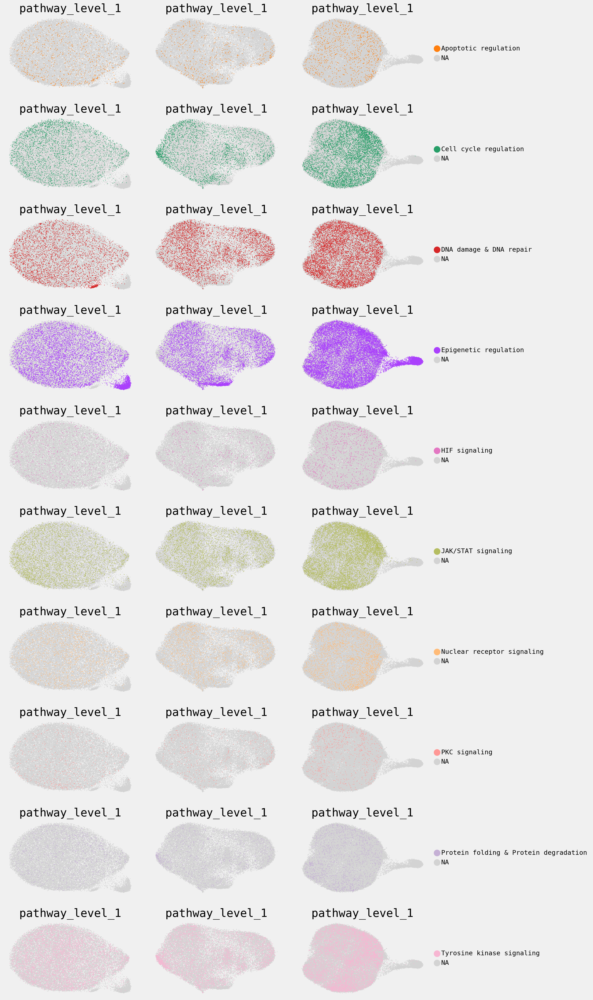

In [16]:
dose = 1e4
cond_A549 = adata_A549.obs.dose==dose
cond_K562 = adata_K562.obs.dose==dose
cond_MCF7 = adata_MCF7.obs.dose==dose

cols = 3
rows = len(pathways)
size = 7
fig, ax = plt.subplots(rows, cols, figsize=(6*cols, 3*rows))

for i, pw in enumerate(pathways):
    sc.pl.umap(adata_A549[cond_A549].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               size=size
              )
    sc.pl.umap(adata_K562[cond_K562].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               size=size
              )
    sc.pl.umap(adata_MCF7[cond_MCF7].copy(), 
               color='pathway_level_1', 
               groups=pw, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               size=size
              )
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()

## Distribution of drugs with maximal dosage

### Identifying significant drugs for perturbations

The relevant information is take from Fig.S6 from the [supplement material](https://www.science.org/doi/suppl/10.1126/science.aax6234/suppl_file/aax6234-srivatsan-sm.pdf) of the orignial [paper](https://www.science.org/doi/full/10.1126/science.aax6234)

In [17]:
epigenetic_drugs = [
    'Dacinostat', 
    'Quisinostat', 
    'CUDC-907', 
    'Abexinostat',
    'Panobinostat',
    'Belinostat',
    'Givinostat',
    'Mocetinostat', #no_ood
    'Pracinostat', #no_ood
    'AR-42', 
    'Entinostat', #no_ood
    'Tucidinostat', #no_ood
    'Tacedinaline', #no_ood
    'Trichostatin', 
    'CUDC-101',
    'M344',
    'Resminostat',
]

dna_damage_drugs = [
    'Raltitrexed', #no_ood
    'Pirarubicin', 
]

cell_cycle_drugs = [
    'Epothilone',
    'Patupilone', #no_ood
    'Flavopiridol',
    'Hesperadin',
    'GSK1070916', #no_ood
]

apoptosis_drugs = [
    'JNJ-26854165' #no_ood
]

tyrosine_drugs = [
    'Trametinib', #no_ood
    'TAK-901',  #no_ood
    'Dasatinib' #no_ood
]

protein_drugs = [
    'Alvespimycin',
    'Tanespimycin',
    'Luminespib'
]


# Create list of potential ood_drugs
ood_drugs = ['control']
ood_drugs.extend(epigenetic_drugs)
ood_drugs.extend(dna_damage_drugs)
ood_drugs.extend(cell_cycle_drugs)
ood_drugs.extend(apoptosis_drugs)
ood_drugs.extend(tyrosine_drugs)
ood_drugs.extend(protein_drugs)

Create pathway dependent colour palette for more informative plotting 

In [18]:
grey_palette = dict(zip(adata_A549.obs.condition.cat.categories.values, 188*['red']))

colours = (
    ['grey']
    + len(epigenetic_drugs)*['008fd5'] 
    + len(dna_damage_drugs)*['fc4f30'] 
    + len(cell_cycle_drugs)*['e5ae38'] 
    + len(apoptosis_drugs)*['6d904f']
    + len(tyrosine_drugs)*['8b8b8b']
    + len(protein_drugs)*['810f7c']
)

palette = dict(zip(ood_drugs, colours))
for drug, colour in palette.items():
    if drug =='control': 
        continue
    if isinstance(colour, str):
        grey_palette[drug] = '#' + colour

### LINCS Genes

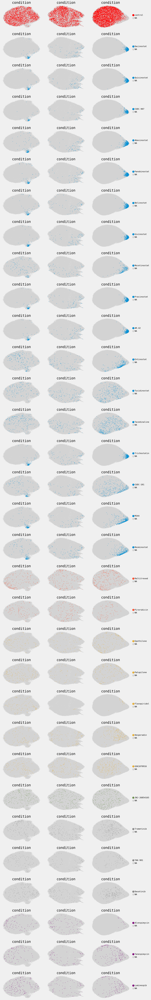

In [19]:
dose = 1e4
cond_A549 = (adata_A549_lincs_genes.obs.dose==dose) | (adata_A549_lincs_genes.obs.condition == 'control')
cond_K562 = (adata_K562_lincs_genes.obs.dose==dose) | (adata_K562_lincs_genes.obs.condition == 'control')
cond_MCF7 = (adata_MCF7_lincs_genes.obs.dose==dose) | (adata_MCF7_lincs_genes.obs.condition == 'control')

cols = 3
rows = len(ood_drugs)
fig, ax = plt.subplots(rows, cols, figsize=(5*cols, 3*rows))

for i, drug in enumerate(ood_drugs):
    sc.pl.umap(adata_A549_lincs_genes[cond_A549].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_K562_lincs_genes[cond_K562].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_MCF7_lincs_genes[cond_MCF7].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              ) 
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()


### All genes

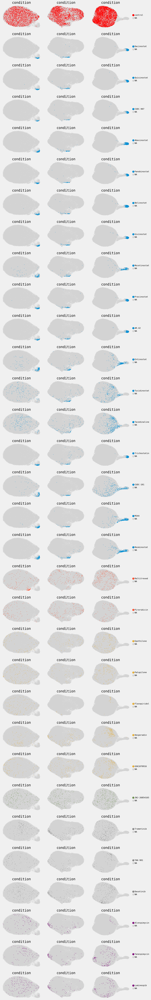

In [20]:
dose = 1e4
cond_A549 = (adata_A549.obs.dose==dose) | (adata_A549.obs.condition == 'control')
cond_K562 = (adata_K562.obs.dose==dose) | (adata_K562.obs.condition == 'control')
cond_MCF7 = (adata_MCF7.obs.dose==dose) | (adata_MCF7.obs.condition == 'control')

cols = 3
rows = len(ood_drugs)
fig, ax = plt.subplots(rows, cols, figsize=(5*cols, 3*rows))

for i, drug in enumerate(ood_drugs):
    sc.pl.umap(adata_A549[cond_A549].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_K562[cond_K562].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_MCF7[cond_MCF7].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              ) 
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()

## Create data split

### Divide into `'train'`, `'test'`, and `'ood'`

In [21]:
validation_drugs = [    
    'Alvespimycin',  
    'Luminespib',
    'Epothilone',
    'Flavopiridol',
    'Quisinostat', 
    'Abexinostat',
    'Panobinostat',
    'AR-42', 
    'Trichostatin', 
    'M344',
    'Resminostat',
    'Belinostat', #ood
    'Mocetinostat', #no_ood
    'Pracinostat', #no_ood
    'Entinostat', #no_ood
    'Tucidinostat', #no_ood
    'Tacedinaline', #no_ood
    'Patupilone', #no_ood
    'GSK1070916', #no_ood
    'JNJ-26854165' #no_ood
    'TAK-901',  #no_ood
    'Dasatinib' #no_ood
]
    
    
ood_drugs = [
    'Dacinostat', #ood
    'CUDC-907', #ood     
    'Givinostat', #ood
    'CUDC-101', #ood
    'Pirarubicin', #ood 
    'Hesperadin', #ood
    'Tanespimycin', #ood
    'Trametinib', #ood
    'Raltitrexed', #no_ood
]
    
additional_validation_drugs = [
    'YM155', #apoptosis
    'Barasertib', #cell cycle
    'Fulvestrant', #nuclear receptor
    'Nintedanib', #tyrosine
    'Rigosertib', #tyrosine 
    'BMS-754807', #tyrosine
    'KW-2449', #tyrosine
    'Crizotinib', #tyrosin
    'ENMD-2076', #cell cycle 
    'Alisertib', #cell cycle
    'JQ1', #epigenetic
]

validation_drugs.extend(additional_validation_drugs)

### Plot additonal validation drugs on all genes data

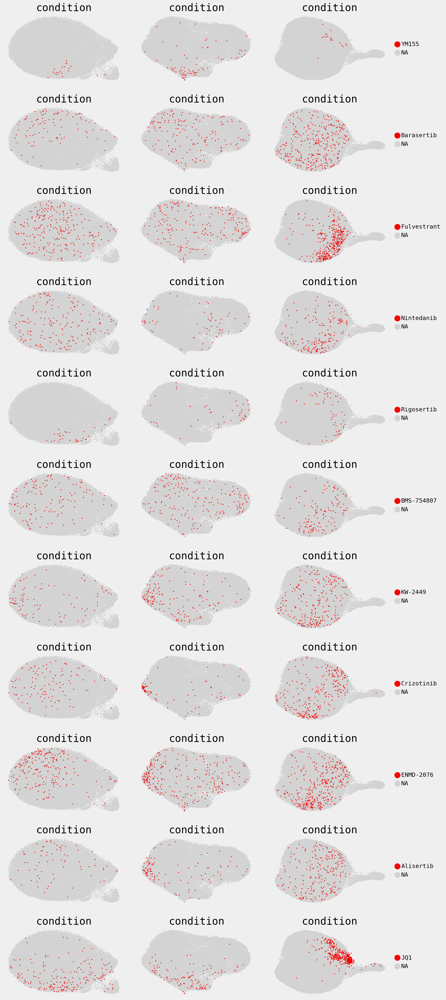

In [22]:
dose = 1e4
cond_A549 = (adata_A549.obs.dose==dose) | (adata_A549.obs.condition == 'control')
cond_K562 = (adata_K562.obs.dose==dose) | (adata_K562.obs.condition == 'control')
cond_MCF7 = (adata_MCF7.obs.dose==dose) | (adata_MCF7.obs.condition == 'control')

cols = 3
rows = len(additional_validation_drugs)
fig, ax = plt.subplots(rows, cols, figsize=(5*cols, 3*rows))

for i, drug in enumerate(additional_validation_drugs):
    sc.pl.umap(adata_A549[cond_A549].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 0],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_K562[cond_K562].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 1],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              )
    sc.pl.umap(adata_MCF7[cond_MCF7].copy(), 
               color='condition', 
               groups=drug, 
               show=False, 
               ax=ax[i, 2],
               legend_fontsize='xx-small',
               palette=grey_palette,
               size=20
              ) 
    ax[i, 0].get_legend().remove()
    ax[i, 1].get_legend().remove()

plt.tight_layout()

In [60]:
# train
adata_sciplex.obs['split_ood_finetuning'] = 'train'

# ood
adata_sciplex.obs.loc[adata_sciplex.obs.condition.isin(ood_drugs), 'split_ood_finetuning'] = 'ood'

# test
validation_cond = (adata_sciplex.obs.condition.isin(validation_drugs)) & (adata_sciplex.obs.dose.isin([1e3, 1e4]))
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

validation_cond = (adata_sciplex.obs.condition.isin(validation_drugs)) & (adata_sciplex.obs.dose.isin([1e1, 1e2]))
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.2, copy=True).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

validation_cond = (adata_sciplex.obs.split_ood_finetuning == 'train')
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.04, copy=True).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

validation_cond = (adata_sciplex.obs.split_ood_finetuning == 'train') & (adata_sciplex.obs.control.isin([1]))
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.05, copy=True).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

In [61]:
adata_sciplex.obs.condition.value_counts()

control            13004
ENMD-2076           5757
PD98059             3763
Tranylcypromine     3744
WP1066              3722
                   ...  
AT9283              1795
Patupilone          1481
Flavopiridol        1407
Epothilone          1221
YM155                770
Name: condition, Length: 188, dtype: int64

In [62]:
adata_sciplex.obs['split_ood_finetuning'].value_counts()

train    513475
test      45520
ood       22782
Name: split_ood_finetuning, dtype: int64

In [63]:
pd.crosstab(adata_sciplex.obs['split_ood_finetuning'], 
            adata_sciplex.obs['condition'][adata_sciplex.obs['condition'].isin(ood_drugs)])

condition,CUDC-101,CUDC-907,Dacinostat,Givinostat,Hesperadin,Pirarubicin,Raltitrexed,Tanespimycin,Trametinib
split_ood_finetuning,,,,,,,,,
ood,3209,2417,2516,3105,1949,2388,2514,2210,2474


In [64]:
pd.crosstab(adata_sciplex.obs.loc[adata_sciplex.obs['split_ood_finetuning']=='ood','dose'], 
            adata_sciplex.obs.loc[adata_sciplex.obs['split_ood_finetuning']=='ood','condition'])

condition,CUDC-101,CUDC-907,Dacinostat,Givinostat,Hesperadin,Pirarubicin,Raltitrexed,Tanespimycin,Trametinib
dose,,,,,,,,,
10.0,1027,798,780,896,567,674,617,813,443
100.0,831,660,572,878,432,676,640,599,693
1000.0,763,592,556,708,512,700,577,422,789
10000.0,588,367,608,623,438,338,680,376,549


In [65]:
pd.crosstab(adata_sciplex.obs['split_ood_finetuning'], 
            adata_sciplex.obs['condition'][adata_sciplex.obs['condition'].isin(validation_drugs)])

condition,JQ1,AR-42,Abexinostat,Alisertib,Alvespimycin,BMS-754807,Barasertib,Belinostat,Crizotinib,Dasatinib,ENMD-2076,Entinostat,Epothilone,Flavopiridol,Fulvestrant,GSK1070916,KW-2449,Luminespib,M344,Mocetinostat,Nintedanib,Panobinostat,Patupilone,Pracinostat,Quisinostat,Resminostat,Rigosertib,Tacedinaline,Trichostatin,Tucidinostat,YM155
split_ood_finetuning,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
test,1022,908,963,672,504,843,783,972,882,805,1787,1083,411,370,1085,783,941,631,953,692,906,874,520,924,763,1043,557,1200,948,756,230
train,2015,1993,1950,1429,1354,1833,1638,2053,1904,1733,3970,2302,810,1037,2335,1719,2091,1374,2201,1286,2089,1699,961,2018,1591,2276,1382,2464,2135,1497,540


In [66]:
pd.crosstab(adata_sciplex.obs.loc[adata_sciplex.obs['split_ood_finetuning']=='test', 'dose'], 
            adata_sciplex.obs.loc[adata_sciplex.obs['split_ood_finetuning']=='test','condition'])

condition,2-Methoxyestradiol,JQ1,A-366,ABT-737,AC480,AG-490,AG-14361,AICAR,AMG-900,AR-42,AT9283,AZ,AZD1480,Abexinostat,Alendronate,Alisertib,Altretamine,Alvespimycin,Aminoglutethimide,Amisulpride,Anacardic,Andarine,Aurora,Avagacestat,Azacitidine,BMS-265246,BMS-536924,BMS-754807,BMS-911543,BRD4770,Barasertib,Baricitinib,Belinostat,Bisindolylmaleimide,Bosutinib,Busulfan,CEP-33779,CYC116,Capecitabine,Carmofur,Cediranib,Celecoxib,Cerdulatinib,Cimetidine,Clevudine,Costunolide,Crizotinib,Curcumin,Cyclocytidine,Danusertib,...,Rigosertib,Roscovitine,Roxadustat,Rucaparib,Ruxolitinib,S3I-201,S-Ruxolitinib,SB431542,SGI-1776,SL-327,SNS-314,SRT1720,SRT2104,SRT3025,Selisistat,Sirtinol,Sodium,Sorafenib,Streptozotocin,TAK-901,TG101209,TGX-221,TMP195,Tacedinaline,Tazemetostat,Temsirolimus,Thalidomide,Thiotepa,Tie2,Tofacitinib,Toremifene,Tozasertib,Tranylcypromine,Triamcinolone,Trichostatin,Tubastatin,Tucidinostat,UNC0379,UNC0631,UNC1999,Valproic,Vandetanib,Veliparib,WHI-P154,WP1066,XAV-939,YM155,ZM,Zileuton,control
dose,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1132
10.0,33,190,40,37,41,34,38,36,26,202,25,40,34,194,32,146,23,165,33,32,44,35,37,36,38,38,32,185,12,44,150,25,208,33,24,40,27,35,36,40,34,39,45,32,33,47,200,38,38,36,...,179,31,20,28,37,29,39,15,43,33,18,26,43,32,26,37,41,35,36,22,41,41,38,240,44,15,25,33,27,33,38,29,39,40,197,48,193,34,33,43,37,42,38,32,46,25,66,25,40,0
100.0,33,158,28,37,35,45,45,39,25,187,15,34,36,169,37,121,36,102,42,27,42,22,23,32,31,43,32,151,30,42,133,36,187,36,25,32,34,37,41,23,36,23,33,29,40,32,175,36,36,30,...,163,27,21,25,24,26,33,31,32,29,21,29,24,31,33,33,40,30,33,30,36,37,16,226,41,24,35,31,28,31,39,12,35,34,188,38,89,34,23,29,47,40,29,41,29,36,51,30,32,0
1000.0,35,328,29,28,30,34,33,30,18,262,12,32,22,278,14,237,41,163,17,22,35,26,31,36,43,26,31,319,40,42,251,31,313,29,18,43,35,21,46,34,31,22,42,37,33,24,305,35,34,19,...,157,29,44,18,22,29,32,44,27,29,18,33,34,30,35,32,37,41,24,13,26,33,16,371,24,26,39,22,26,39,33,19,38,29,314,32,193,40,37,30,35,30,29,39,44,38,58,18,36,0
10000.0,21,346,41,31,29,38,28,44,25,257,20,16,12,322,33,168,40,74,37,29,28,38,28,38,31,25,26,188,31,31,249,33,264,1,11,24,35,27,30,25,21,30,31,27,31,37,202,35,21,21,...,58,34,41,32,36,42,30,42,17,37,19,42,56,32,34,37,32,16,33,8,18,24,26,363,44,18,35,31,21,29,16,22,36,44,249,26,281,25,37,34,35,17,32,33,25,17,55,24,34,0


## Add epigenetic holdout split

In [ ]:
# train
adata_sciplex.obs['split_ood_finetuning'] = 'train'

# ood
adata_sciplex.obs.loc[adata_sciplex.obs.condition.isin(ood_drugs), 'split_ood_finetuning'] = 'ood'


validation_cond = (adata_sciplex.obs.split_ood_finetuning == 'train')
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.04, copy=True).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

validation_cond = (adata_sciplex.obs.split_ood_finetuning == 'train') & (adata_sciplex.obs.control.isin([1]))
val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.05, copy=True).obs.index
adata_sciplex.obs.loc[val_idx, 'split_ood_finetuning'] = 'test'

In [26]:
adata_sciplex.obs.condition.isin(epigenetic_drugs_all).sum()

147875

In [4]:
from sklearn.model_selection import train_test_split

epigenetic_drugs_all = adata_sciplex.obs.condition[adata_sciplex.obs.pathway_level_1 == "Epigenetic regulation"].unique()

epigenetic_drugs = [
    'Dacinostat', 
    'Quisinostat', 
    'CUDC-907', 
    'Abexinostat',
    'Panobinostat',
    'Belinostat',
    'Givinostat',
    'AR-42', 
    'Trichostatin', 
    'CUDC-101',
    'M344',
    'Resminostat',
    'Entinostat', #no_ood
    'Tucidinostat', #no_ood
    'Tacedinaline', #no_ood
    'Mocetinostat', #no_ood
    'Pracinostat', #no_ood
]

ood_epi_drugs = [
    'Dacinostat', 
    'Quisinostat', 
    'CUDC-907', 
    'Abexinostat',
    'Panobinostat',
    'Belinostat',
    'Givinostat',
    'AR-42',
]

val_epi_drugs = [
    'Trichostatin', 
    'CUDC-101',
    'M344',
    'Resminostat',
    'Entinostat', #no_ood
    'Tucidinostat', #no_ood
    'Tacedinaline', #no_ood
    'Mocetinostat', #no_ood
    'Pracinostat', #no_ood
]    
    

In [21]:
if 'split_ho_epigenetic' not in list(adata_sciplex.obs):
    print("Addig 'split_ho_epigenetic' to 'adata_sciplex.obs'.")
    obs_train, obs_val = train_test_split(adata_sciplex.obs.index, test_size=0.05)
#     obs_val, obs_test = train_test_split(obs_tmp, test_size=0.5)

    adata_sciplex.obs['split_ho_epigenetic'] = 'train'
    adata_sciplex.obs.loc[adata_sciplex.obs.index.isin(obs_val), 'split_ho_epigenetic'] = 'test'
    
    # test
    validation_cond = (adata_sciplex.obs.condition.isin(val_epi_drugs)) & (adata_sciplex.obs.dose.isin([1e3, 1e4]))
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic'] = 'test'
    

    validation_cond = (adata_sciplex.obs.condition.isin(val_epi_drugs)) & (adata_sciplex.obs.dose.isin([1e1, 1e2]))
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic'] = 'test'
    
    validation_cond = adata_sciplex.obs.condition.isin(epigenetic_drugs_all[~epigenetic_drugs_all.isin(epigenetic_drugs)])
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic'] = 'test'
    
    validation_cond = adata_sciplex.obs.control.isin([True])
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic'] = 'test'
    
    adata_sciplex.obs.loc[adata_sciplex.obs.condition.isin(ood_epi_drugs), 'split_ho_epigenetic'] = 'ood'

Addig 'split_ho_epigenetic' to 'adata_sciplex.obs'.


In [22]:
if 'split_ho_epigenetic_all' not in list(adata_sciplex.obs):
    print("Addig 'split_ho_epigenetic_all' to 'adata_sciplex.obs'.")
    obs_train, obs_val = train_test_split(adata_sciplex.obs.index, test_size=0.05)
#     obs_val, obs_test = train_test_split(obs_tmp, test_size=0.5)

    adata_sciplex.obs['split_ho_epigenetic_all'] = 'train'
    adata_sciplex.obs.loc[adata_sciplex.obs.index.isin(obs_val), 'split_ho_epigenetic_all'] = 'test'
    
    validation_cond = adata_sciplex.obs.condition.isin(epigenetic_drugs_all[~epigenetic_drugs_all.isin(epigenetic_drugs)])
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.5, copy=True).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic_all'] = 'test'
    
    validation_cond = adata_sciplex.obs.control.isin([True])
    val_idx = sc.pp.subsample(adata_sciplex[validation_cond], 0.4, copy=True).obs.index
    adata_sciplex.obs.loc[val_idx, 'split_ho_epigenetic_all'] = 'test'
    
    adata_sciplex.obs.loc[adata_sciplex.obs.condition.isin(epigenetic_drugs), 'split_ho_epigenetic_all'] = 'ood'
    

Addig 'split_ho_epigenetic_all' to 'adata_sciplex.obs'.


In [23]:
pd.crosstab(
    adata_sciplex.obs.split_ho_epigenetic,
    adata_sciplex.obs.control
)

control,0,1
split_ho_epigenetic,,
ood,21804,0
test,75175,5610
train,471794,7394


In [24]:
pd.crosstab(
    adata_sciplex.obs.split_ho_epigenetic_all,
    adata_sciplex.obs.control
)

control,0,1
split_ho_epigenetic_all,,
ood,48791,0
test,72976,5610
train,447006,7394


## Add random split

In [25]:
if 'split_random' not in list(adata_sciplex.obs):
    print("Addig 'split_random' to 'adata_sciplex.obs'.")
    obs_train, obs_tmp = train_test_split(adata_sciplex.obs.index, test_size=0.3)
    obs_val, obs_test = train_test_split(obs_tmp, test_size=0.5)

    adata_sciplex.obs['split_random'] = 'train'
    adata_sciplex.obs.loc[adata_sciplex.obs.index.isin(obs_val), 'split_random'] = 'test'
    adata_sciplex.obs.loc[adata_sciplex.obs.index.isin(obs_test), 'split_random'] = 'ood'

Addig 'split_random' to 'adata_sciplex.obs'.


In [26]:
pd.crosstab(
    adata_sciplex.obs.split_random,
    adata_sciplex.obs.control
)

control,0,1
split_random,,
ood,85381,1886
test,85211,2056
train,398181,9062


## Save `adata_sciplex` and `adata_sciplex_lincs_genes`

In [7]:
assert (adata_sciplex.obs.index == adata_sciplex_lincs_genes.obs.index).all()

adata_sciplex_lincs_genes.obs['split_ood_finetuning'] = adata_sciplex.obs['split_ood_finetuning']
adata_sciplex_lincs_genes.obs['split_ho_epigenetic'] = adata_sciplex.obs['split_ho_epigenetic']
adata_sciplex_lincs_genes.obs['split_ho_epigenetic_all'] = adata_sciplex.obs['split_ho_epigenetic_all']
adata_sciplex_lincs_genes.obs['split_random'] = adata_sciplex.obs['split_random']

In [29]:
sc.write(PROJECT_DIR/'datasets'/'sciplex_complete.h5ad', adata_sciplex)

/home/icb/leon.hetzel/miniconda3/envs/chemical_CPA/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'split_ho_epigenetic' as categorical
/home/icb/leon.hetzel/miniconda3/envs/chemical_CPA/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  c.reorder_categories(natsorted(c.categories), inplace=True)
... storing 'split_ho_epigenetic_all' as categorical
/home/icb/leon.hetzel/miniconda3/envs/chemical_CPA/lib/python3.7/site-packages/anndata/_core/anndata.py:1228: FutureWarning: The `inplace` parameter i

In [8]:
sc.write(PROJECT_DIR/'datasets'/'sciplex_complete_lincs_genes.h5ad', adata_sciplex_lincs_genes)

______

In [4]:
adata_sciplex = sc.read(PROJECT_DIR/'datasets'/'sciplex_complete.h5ad')
adata_sciplex

AnnData object with n_obs × n_vars = 581777 × 2000
    obs: 'cell_type', 'dose', 'dose_character', 'dose_pattern', 'g1s_score', 'g2m_score', 'pathway', 'pathway_level_1', 'pathway_level_2', 'product_dose', 'product_name', 'proliferation_index', 'replicate', 'size_factor', 'target', 'vehicle', 'batch', 'n_counts', 'dose_val', 'condition', 'drug_dose_name', 'cov_drug_dose_name', 'cov_drug', 'control', 'split_ho_pathway', 'split_tyrosine_ood', 'split_epigenetic_ood', 'split_cellcycle_ood', 'SMILES', 'split_ood_finetuning', 'split_ho_epigenetic', 'split_ho_epigenetic_all', 'split_random'
    var: 'id', 'num_cells_expressed-0-0', 'num_cells_expressed-1-0', 'num_cells_expressed-1', 'gene_id', 'in_lincs', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'all_DEGs', 'hvg', 'lincs_DEGs', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

In [5]:
adata_sciplex_lincs_genes = sc.read(PROJECT_DIR/'datasets'/'sciplex_complete_lincs_genes.h5ad')
adata_sciplex_lincs_genes

AnnData object with n_obs × n_vars = 581777 × 977
    obs: 'cell_type', 'dose', 'dose_character', 'dose_pattern', 'g1s_score', 'g2m_score', 'pathway', 'pathway_level_1', 'pathway_level_2', 'product_dose', 'product_name', 'proliferation_index', 'replicate', 'size_factor', 'target', 'vehicle', 'batch', 'n_counts', 'dose_val', 'condition', 'drug_dose_name', 'cov_drug_dose_name', 'cov_drug', 'control', 'split_ho_pathway', 'split_tyrosine_ood', 'split_epigenetic_ood', 'split_cellcycle_ood', 'SMILES', 'split_ood_finetuning', 'split_ho_epigenetic', 'split_ho_epigenetic_all', 'split_random'
    var: 'id', 'num_cells_expressed-0-0', 'num_cells_expressed-1-0', 'num_cells_expressed-1', 'gene_id', 'in_lincs', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'all_DEGs', 'hvg', 'lincs_DEGs', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

_________

### Check splits

In [70]:
pd.crosstab(
    adata_sciplex.obs.split_ood_finetuning,
    adata_sciplex.obs.control
)

control,0,1
split_ood_finetuning,,
ood,22782,0
test,44388,1132
train,501603,11872


In [37]:
pd.crosstab(
    adata_sciplex.obs.split_ho_pathway,
    adata_sciplex.obs.control
)

control,0,1
split_ho_pathway,,
ood,12423,0
test,83439,1964
train,472911,11040


____

## Create small sciplex dataset

In [6]:
adatas = []

for perturbation in np.unique(adata.obs.condition): 
    tmp = adata[adata.obs.condition == perturbation].copy()
    tmp = sc.pp.subsample(tmp, n_obs=40, copy=True)
    adatas.append(tmp)

adata_subset = adatas[0].concatenate(adatas[1:])
adata_subset.uns = adata.uns.copy()

adata_subset

AnnData object with n_obs × n_vars = 7520 × 977
    obs: 'cell_type', 'dose', 'dose_character', 'dose_pattern', 'g1s_score', 'g2m_score', 'pathway', 'pathway_level_1', 'pathway_level_2', 'product_dose', 'product_name', 'proliferation_index', 'replicate', 'size_factor', 'target', 'vehicle', 'batch', 'n_counts', 'dose_val', 'condition', 'drug_dose_name', 'cov_drug_dose_name', 'cov_drug', 'control', 'split_ho_pathway', 'split_tyrosine_ood', 'split_epigenetic_ood', 'split_cellcycle_ood', 'SMILES', 'split_ood_finetuning'
    var: 'id', 'gene_id', 'in_lincs', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'num_cells_expressed-0-0', 'num_cells_expressed-1-0', 'num_cells_expressed-1'
    uns: 'all_DEGs', 'hvg', 'lincs_DEGs', 'neighbors', 'pca', 'umap'
    obsm: 'X_pca', 'X_umap'

In [16]:
if 'split' not in list(adata_subset.obs):
    print("Addig 'split' to 'adata_subset.obs'.")
    obs_train, obs_tmp = train_test_split(adata_subset.obs.index, test_size=0.3)
    obs_val, obs_test = train_test_split(obs_tmp, test_size=0.5)

    adata_subset.obs['split'] = 'train'
    adata_subset.obs.loc[adata_subset.obs.index.isin(obs_val), 'split'] = 'test'
    adata_subset.obs.loc[adata_subset.obs.index.isin(obs_test), 'split'] = 'ood'

Addig 'split' to 'adata_subset.obs'.


In [17]:
adata_subset.obs.split.value_counts()

train    5264
test     1128
ood      1128
Name: split, dtype: int64

In [18]:
sc.write(PROJECT_DIR/'datasets'/'sciplex_complete_subset_lincs_genes.h5ad', adata_subset)

... storing 'dose_character' as categorical
... storing 'pathway' as categorical
... storing 'pathway_level_1' as categorical
... storing 'pathway_level_2' as categorical
... storing 'product_dose' as categorical
... storing 'product_name' as categorical
... storing 'target' as categorical
... storing 'condition' as categorical
... storing 'drug_dose_name' as categorical
... storing 'cov_drug_dose_name' as categorical
... storing 'cov_drug' as categorical
... storing 'split_ho_pathway' as categorical
... storing 'split_tyrosine_ood' as categorical
... storing 'split_epigenetic_ood' as categorical
... storing 'split_cellcycle_ood' as categorical
... storing 'SMILES' as categorical
... storing 'split_ood_finetuning' as categorical
... storing 'split' as categorical


____

## Create middle sized sci-Plex subset

In [65]:
delete_idx =[]
for drug, df in adata_sciplex.obs.groupby('condition'): 
    # Low dose
    cond = df.dose.isin([10])
    idx = df[cond].sample(frac=0.6).index
    delete_idx.extend(idx)
    # Small dose
    cond = df.dose.isin([100])
    idx = df[cond].sample(frac=0.5).index
    delete_idx.extend(idx)
    # Middle dose 
    cond = df.dose.isin([1000])
    idx = df[cond].sample(frac=0.3).index
    delete_idx.extend(idx)
    # High dose 
    cond = df.dose.isin([10000])
    idx = df[cond].sample(frac=0.15).index
    delete_idx.extend(idx)

In [66]:
cond = ~pd.Series(adata_sciplex.obs.index).isin(delete_idx)

In [67]:
cond.sum()

354640

In [68]:
cond = cond.to_list()

In [78]:
assert (adata_sciplex.obs.index == adata_sciplex_lincs_genes.obs.index).all()

In [79]:
adata = adata_sciplex[cond].copy()
adata_lincs_genes = adata_sciplex_lincs_genes[cond].copy()

In [80]:
pd.crosstab(
    adata.obs.split_ood_finetuning,
    adata.obs.control
)

control,0,1
split_ood_finetuning,,
ood,13451,0
test,27652,1132
train,300533,11872


In [81]:
pd.crosstab(
    adata.obs.split_ho_pathway,
    adata.obs.control
)

control,0,1
split_ho_pathway,,
ood,10559,0
test,49834,1964
train,281243,11040


In [82]:
sc.write(PROJECT_DIR/'datasets'/'sciplex_complete_middle_subset.h5ad', adata)

In [83]:
sc.write(PROJECT_DIR/'datasets'/'sciplex_complete_middle_subset_lincs_genes.h5ad', adata_lincs_genes)